# EDA

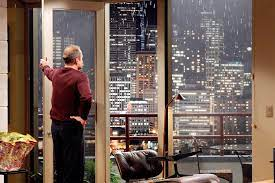

In [167]:

import warnings

warnings.filterwarnings("ignore")

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import psycopg2
import plotly.express as px
import geopandas as gpd
import geodatasets
import folium
from folium import plugins
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import StandardScaler


from matplotlib.ticker import PercentFormatter
plt.rcParams.update({ "figure.figsize" : (8, 5),"axes.facecolor" : "white", "axes.edgecolor":  "black"})
plt.rcParams["figure.facecolor"]= "w"
pd.plotting.register_matplotlib_converters()
pd.set_option('display.float_format', lambda x: '%.3f' % x)

ModuleNotFoundError: No module named 'sklearn'

In [6]:
import os
from dotenv import load_dotenv

load_dotenv()

DATABASE = os.getenv('DATABASE')
USER_DB = os.getenv('USER_DB')
PASSWORD = os.getenv('PASSWORD')
HOST = os.getenv('HOST')
PORT = os.getenv('PORT')

In [7]:
# Create connection object conn
conn = psycopg2.connect(
    database=DATABASE,
    user=USER_DB,
    password=PASSWORD,
    host=HOST,
    port=PORT
)

In [8]:
# import the data into a pandas dataframe
query_string = 'SELECT * FROM eda.king_county_house_details kchd INNER JOIN eda.king_county_house_sales kchs ON kchd.id = kchs."house_id"'
df_housing = pd.read_sql(query_string, conn)

In [9]:
df_housing.head()

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date,price,house_id,id
0,7129300520,3.000,1.000,1180.000,5650.000,1.000,NaN,0.000,3,7,...,0.000,98178,47.511,-122.257,1340.000,5650.000,2014-10-13,221900.000,7129300520,1
1,6414100192,3.000,2.250,2570.000,7242.000,2.000,0.000,0.000,3,7,...,19910.000,98125,47.721,-122.319,1690.000,7639.000,2014-12-09,538000.000,6414100192,2
2,5631500400,2.000,1.000,770.000,10000.000,1.000,0.000,0.000,3,6,...,NaN,98028,47.738,-122.233,2720.000,8062.000,2015-02-25,180000.000,5631500400,3
3,2487200875,4.000,3.000,1960.000,5000.000,1.000,0.000,0.000,5,7,...,0.000,98136,47.521,-122.393,1360.000,5000.000,2014-12-09,604000.000,2487200875,4
4,1954400510,3.000,2.000,1680.000,8080.000,1.000,0.000,0.000,3,8,...,0.000,98074,47.617,-122.045,1800.000,7503.000,2015-02-18,510000.000,1954400510,5


In [10]:
df_housing.shape

(21597, 23)

In [11]:
df_housing.to_csv('data/house_data.csv',index=False)

In [12]:
type(df_housing)

pandas.core.frame.DataFrame

In [78]:
df_housing = pd.read_csv('data/house_data.csv')

In [173]:
!pip install pandas-summary
import pandas_summary as ps

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 144.5/144.5 kB 2.3 MB/s eta 0:00:00 MB/s eta 0:00:01


In [175]:
dfs = ps.DataFrameSummary(df_housing)
print('categoricals: ', dfs.categoricals.tolist())
print('numerics: ', dfs.numerics.tolist())
dfs.summary()

categoricals:  []
numerics:  ['id', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors', 'view', 'condition', 'grade', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long', 'sqft_living15', 'sqft_lot15', 'price', 'house_id']


,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date,price,house_id,equal
count,21597.000,21597.000,21597.000,21597.000,21597.000,21597.000,21597.000,21597.000,21597.000,21597.000,...,21597.000,21597.000,21597.000,21597.000,21597.000,21597.000,NaN,21597.000,21597.000,NaN
mean,4580474287.771,3.373,2.116,2080.322,15099.409,1.494,0.007,0.233,3.410,7.658,...,68.758,98077.952,47.560,-122.214,1986.620,12758.284,NaN,540296.574,4580474287.771,NaN
std,2876735715.748,0.926,0.769,918.106,41412.637,0.540,0.082,0.765,0.651,1.173,...,364.037,53.513,0.139,0.141,685.230,27274.442,NaN,367368.140,2876735715.748,NaN
min,1000102.000,1.000,0.500,370.000,520.000,1.000,0.000,0.000,1.000,3.000,...,0.000,98001.000,47.156,-122.519,399.000,651.000,NaN,78000.000,1000102.000,NaN
25%,2123049175.000,3.000,1.750,1430.000,5040.000,1.000,0.000,0.000,3.000,7.000,...,0.000,98033.000,47.471,-122.328,1490.000,5100.000,NaN,322000.000,2123049175.000,NaN
50%,3904930410.000,3.000,2.250,1910.000,7618.000,1.500,0.000,0.000,3.000,7.000,...,0.000,98065.000,47.572,-122.231,1840.000,7620.000,NaN,450000.000,3904930410.000,NaN
75%,7308900490.000,4.000,2.500,2550.000,10685.000,2.000,0.000,0.000,4.000,8.000,...,0.000,98118.000,47.678,-122.125,2360.000,10083.000,NaN,645000.000,7308900490.000,NaN
max,9900000190.000,33.000,8.000,13540.000,1651359.000,3.500,1.000,4.000,5.000,13.000,...,2015.000,98199.000,47.778,-121.315,6210.000,871200.000,NaN,7700000.000,9900000190.000,NaN
counts,21597,21597,21597,21597,21597,21597,21597,21597,21597,21597,...,21597,21597,21597,21597,21597,21597,21597,21597,21597,21597
uniques,21420,12,29,1034,9776,6,2,5,5,11,...,70,70,5033,752,777,8682,372,3622,21420,1


In [14]:
type(df_housing)

pandas.core.frame.DataFrame

In [115]:
# your code: check for data types and statistics overview of data frame columns
print(df_housing.info())



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   id             21597 non-null  int64         
 1   bedrooms       21597 non-null  float64       
 2   bathrooms      21597 non-null  float64       
 3   sqft_living    21597 non-null  float64       
 4   sqft_lot       21597 non-null  float64       
 5   floors         21597 non-null  float64       
 6   waterfront     21597 non-null  float64       
 7   view           21534 non-null  float64       
 8   condition      21597 non-null  int64         
 9   grade          21597 non-null  int64         
 10  sqft_above     21597 non-null  float64       
 11  sqft_basement  21145 non-null  float64       
 12  yr_built       21597 non-null  int64         
 13  yr_renovated   21597 non-null  int64         
 14  zipcode        21597 non-null  int64         
 15  lat            2159

In [120]:
# check data types in data frame.  **date** column has the data type `Object`.
type(df_housing['date'][0])
# change "date" dtype to datetime with format %Y/%m/%d
df_housing['date'] = pd.to_datetime(df_housing['date'], format='%Y/%m/%d')
# check "date" dtype
type(df_housing['date'][0])


pandas._libs.tslibs.timestamps.Timestamp

In [177]:
import plotly.graph_objects as go

from plotly.subplots import make_subplots

fig = make_subplots(rows=1, cols=1,
                    subplot_titles=("Values For Dataset",))


temp_data=df_housing.nunique().sort_values()

fig.add_trace(
    go.Bar(x=temp_data.index, y=temp_data.values,marker=dict(color='#003f88')),
    row=1, col=1
)

fig.update_layout(height=400)
fig.show()

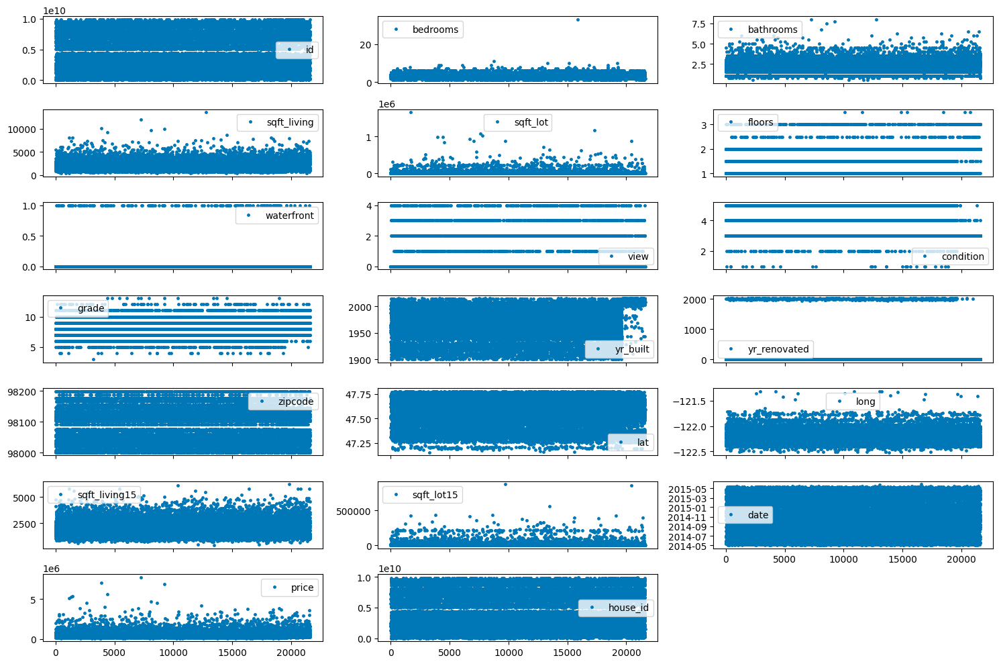

In [178]:
# For all Numerical columnn for all rows 
df_housing.plot(lw=0, marker=".", subplots=True, layout=(-1, 3),
        figsize=(15,10), markersize=5,color='#0077b6')
plt.tight_layout()

'''This plot gives a view of the data distribution for each variable. There are columns present with data type like int but with 
few distinct categories like 'floors', 'waterfront', 'view', etc. But there are columns with many distinct categories like 'price, 'sqft_living', 
'zipcode', etc.

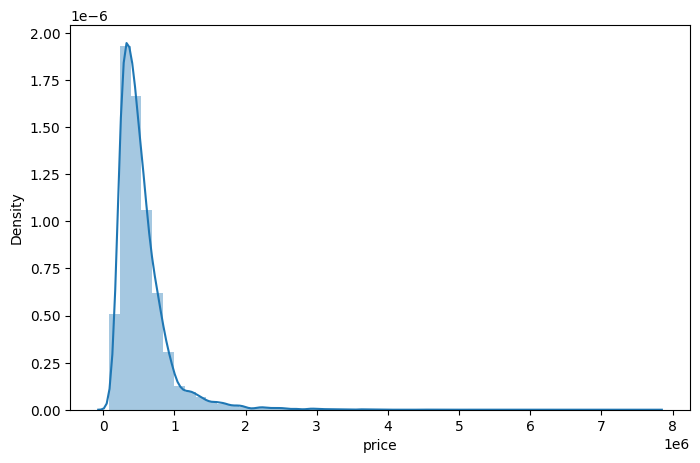

In [180]:
sns.distplot(df_housing['price']);

#There is a deviation from the normal distribution, with positive skewness.

In [182]:
print("Skewness: %f" % df_housing['price'].skew())
print("Kurtosis: %f" % df_housing['price'].kurt())

'''“Skewness essentially is a commonly used measure in descriptive statistics that characterizes the asymmetry of a data distribution, while kurtosis determines the heaviness of the distribution tails.”

Rule of thumb : If the skewness is between -0.5 & 0.5, the data are nearly symmetrical. If the skewness is between -1 & -0.5 (negative skewed) or between 0.5 & 1(positive skewed), the data are slightly skewed. If the skewness is lower than -1 (negative skewed) or greater than 1 (positive skewed), the data are extremely skewed.

What Is Kurtosis? The measure of Kurtosis refers to the tailedness of a distribution. Tailedness refres how often the outliers occur. Excess kurtosis irelative to a normal distribution.'''

Skewness: 4.023365
Kurtosis: 34.541359


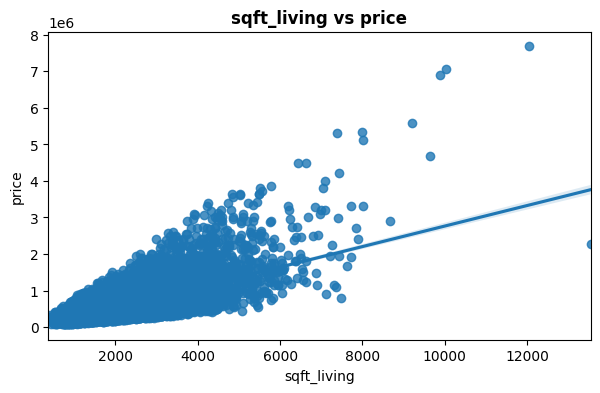

In [183]:
# regplot sqft_living X price
plt.figure(figsize=(7,4))
sns.regplot(data=df_housing, x='sqft_living', y='price')
plt.title('sqft_living vs price', fontweight='bold')

plt.show()

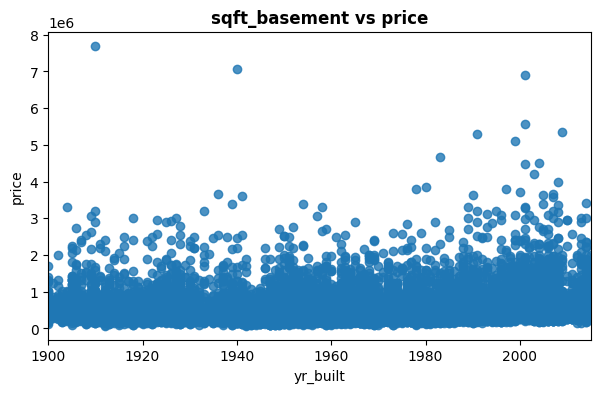

In [185]:
#regplot sqft_basement X price
plt.figure(figsize=(7,4))
sns.regplot(data=df_housing, x='yr_built', y='price')
plt.title('sqft_basement vs price', fontweight='bold')

plt.show()

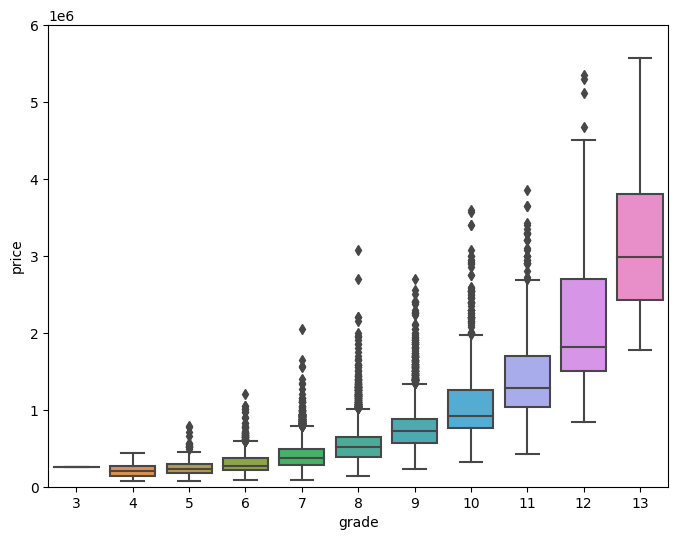

In [186]:
#box plot grade X price
var = 'grade'
data = pd.concat([df_housing['price'], df_housing[var]], axis=1)
f, ax = plt.subplots(figsize=(8, 6))
fig = sns.boxplot(x=var, y="price", data=data)
fig.axis(ymin=0, ymax=6000000);

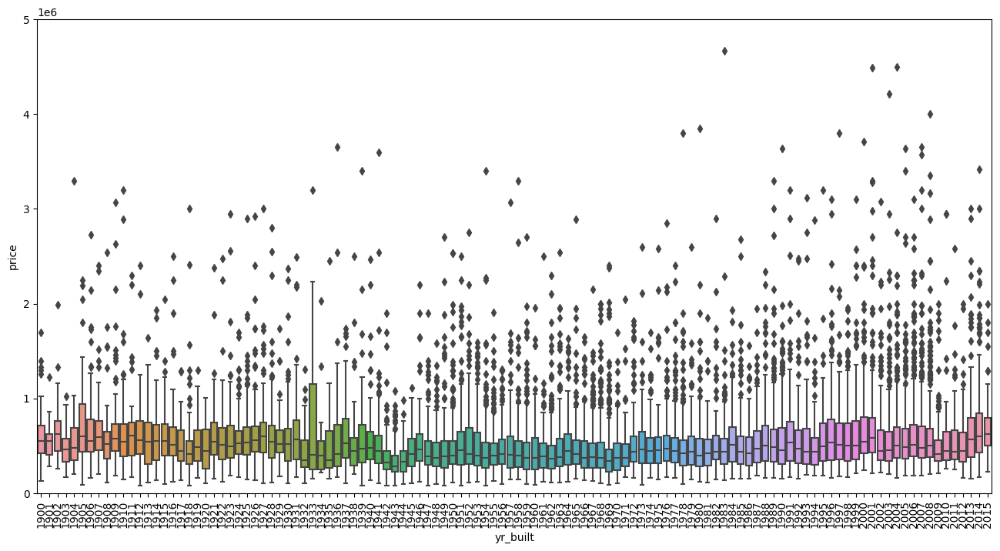

In [187]:
var = 'yr_built'
data = pd.concat([df_housing['price'], df_housing[var]], axis=1)
f, ax = plt.subplots(figsize=(16, 8))
fig = sns.boxplot(x=var, y="price", data=data)
fig.axis(ymin=0, ymax=5000000);
plt.xticks(rotation=90);

In [134]:
for val in df_housing:
    print (df_housing[val].value_counts())
    print()

795000620     3
8910500150    2
7409700215    2
1995200200    2
9211500620    2
             ..
3649100387    1
2767603649    1
1446403617    1
5602000275    1
1523300157    1
Name: id, Length: 21420, dtype: int64

3.000     9824
4.000     6882
2.000     2760
5.000     1601
6.000      272
1.000      196
7.000       38
8.000       13
9.000        6
10.000       3
11.000       1
33.000       1
Name: bedrooms, dtype: int64

2.500    5377
1.000    3851
1.750    3048
2.250    2047
2.000    1930
1.500    1445
2.750    1185
3.000     753
3.500     731
3.250     589
3.750     155
4.000     136
4.500     100
4.250      79
0.750      71
4.750      23
5.000      21
5.250      13
5.500      10
1.250       9
6.000       6
0.500       4
5.750       4
6.750       2
8.000       2
6.250       2
6.500       2
7.500       1
7.750       1
Name: bathrooms, dtype: int64

1300.000    138
1400.000    135
1440.000    133
1800.000    129
1660.000    129
           ... 
2507.000      1
9890.000      1
5584.000  

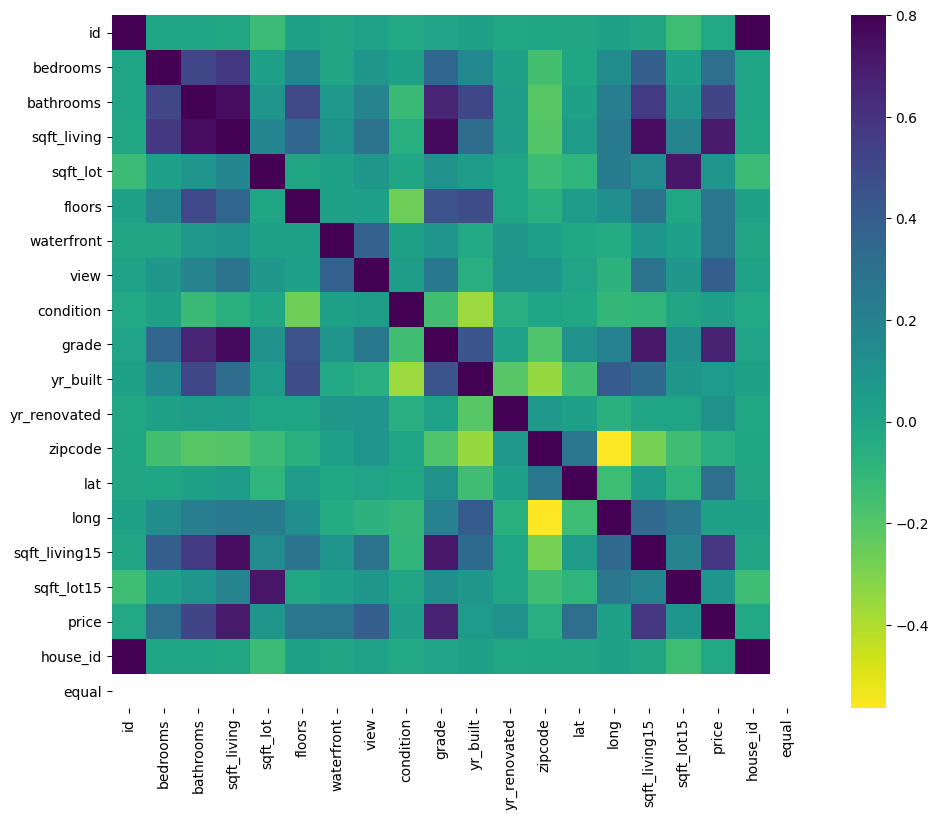

In [188]:
#Data Cleaning
corrmat = df_housing.corr()
f, ax = plt.subplots(figsize=(12, 9))
sns.heatmap(corrmat, vmax=.8, square=True, cmap="viridis_r");

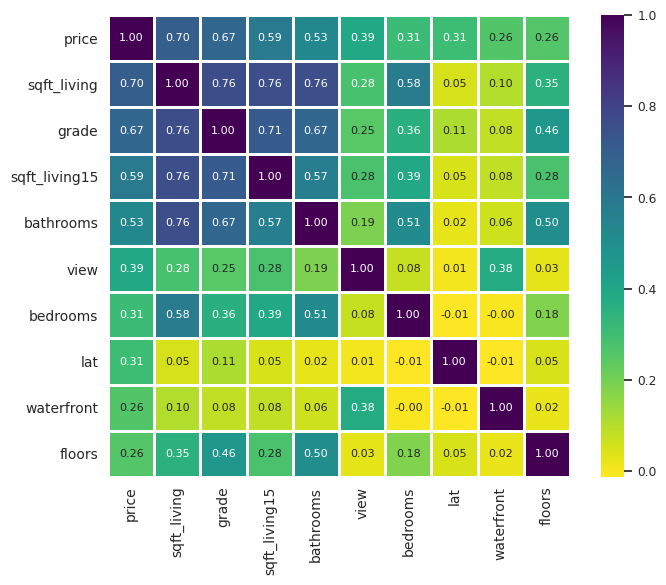

In [190]:
corr = df_housing.corr()
k = 10 #number of variables for heatmap
cols = corr.nlargest(k, 'price')['price'].index
cm = np.corrcoef(df_housing[cols].values.T)

with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(8, 6))
    sns.set(font_scale=0.8)
    ax = sns.heatmap(cm,cbar=True, square=True, annot=True,fmt='0.2f',linewidths=.8,
                    cmap="viridis_r", annot_kws={'size': 8}, yticklabels=cols.values,
                    xticklabels=cols.values)

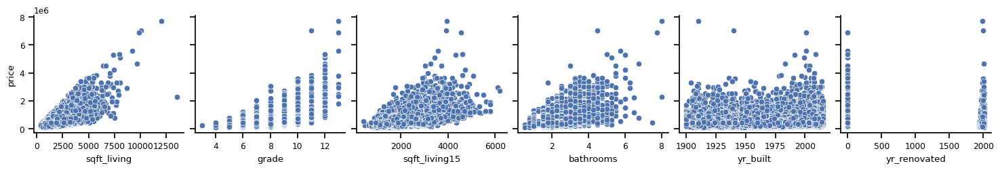

In [194]:
# Pairplot price vs features
cont_features=['sqft_living', 'grade', 'sqft_living15', 'bathrooms', 'yr_built' , 'yr_renovated']
sns.pairplot(data=df_housing,
                y_vars='price',
                x_vars=cont_features)
                
plt.show()

In [131]:
df_housing['yr_renovated'].value_counts()

0       20853
2014       73
2013       31
2003       31
2007       30
        ...  
1951        1
1953        1
1946        1
1976        1
1948        1
Name: yr_renovated, Length: 70, dtype: int64

In [89]:
type(df_housing['yr_renovated'][0])

numpy.float64

In [133]:
# remove extra zero in year renovated column
df_housing.yr_renovated = df_housing.yr_renovated.astype(str)
df_housing['yr_renovated'] = df_housing['yr_renovated'].str[:4]
df_housing['yr_renovated'] = df_housing['yr_renovated'].replace('nan','0.0')
df_housing.yr_renovated = df_housing.yr_renovated.str.strip('.0')
df_housing['yr_renovated'] = df_housing['yr_renovated'].replace('','0')
df_housing['yr_renovated'] = df_housing['yr_renovated'].str.ljust(width=4, fillchar='0')
df_housing['yr_renovated'] = df_housing['yr_renovated'].astype('int64')

df_housing['yr_renovated']

0           0
1        1991
2           0
3           0
4           0
         ... 
21592       0
21593       0
21594       0
21595       0
21596       0
Name: yr_renovated, Length: 21597, dtype: int64

In [121]:
df_housing.isnull().sum()

id                 0
bedrooms           0
bathrooms          0
sqft_living        0
sqft_lot           0
floors             0
waterfront         0
view               0
condition          0
grade              0
sqft_above         0
sqft_basement    452
yr_built           0
yr_renovated       0
zipcode            0
lat                0
long               0
sqft_living15      0
sqft_lot15         0
date               0
price              0
house_id           0
id.1               0
dtype: int64

In [114]:
df_housing.waterfront = df_housing.waterfront.astype(str)
df_housing['waterfront'] = df_housing['waterfront'].replace('nan','0.0')
df_housing['waterfront'] = df_housing['waterfront'].astype('float64')
df_housing['waterfront'].value_counts()

0.000    21451
1.000      146
Name: waterfront, dtype: int64

In [116]:
df_housing.view = df_housing.view.astype(str)
df_housing['view'] = df_housing['view'].replace('nan','0.000')
df_housing['view'] = df_housing['view'].astype('float64')
df_housing['view'].value_counts()

0.000    19485
2.000      957
3.000      508
1.000      330
4.000      317
Name: view, dtype: int64

In [125]:
df_housing.drop(['sqft_basement','sqft_above' ,'id.1'], axis=1, inplace=True).reset_index()


KeyError: "['sqft_basement' 'sqft_above' 'id.1'] not found in axis"

In [126]:
df_housing.head()

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date,price,house_id
0,7129300520,3.000,1.000,1180.000,5650.000,1.000,0.000,0.000,3,7,1955,0,98178,47.511,-122.257,1340.000,5650.000,2014-10-13,221900.000,7129300520
1,6414100192,3.000,2.250,2570.000,7242.000,2.000,0.000,0.000,3,7,1951,1991,98125,47.721,-122.319,1690.000,7639.000,2014-12-09,538000.000,6414100192
2,5631500400,2.000,1.000,770.000,10000.000,1.000,0.000,0.000,3,6,1933,0,98028,47.738,-122.233,2720.000,8062.000,2015-02-25,180000.000,5631500400
3,2487200875,4.000,3.000,1960.000,5000.000,1.000,0.000,0.000,5,7,1965,0,98136,47.521,-122.393,1360.000,5000.000,2014-12-09,604000.000,2487200875
4,1954400510,3.000,2.000,1680.000,8080.000,1.000,0.000,0.000,3,8,1987,0,98074,47.617,-122.045,1800.000,7503.000,2015-02-18,510000.000,1954400510


In [135]:
df_housing[['floors','view','condition','sqft_living','sqft_lot','sqft_living15','sqft_lot15','waterfront','condition','yr_built','yr_renovated']].describe().transpose()

,count,mean,std,min,25%,50%,75%,max
floors,21597.000,1.494,0.540,1.000,1.000,1.500,2.000,3.500
view,21597.000,0.233,0.765,0.000,0.000,0.000,0.000,4.000
condition,21597.000,3.410,0.651,1.000,3.000,3.000,4.000,5.000
sqft_living,21597.000,2080.322,918.106,370.000,1430.000,1910.000,2550.000,13540.000
sqft_lot,21597.000,15099.409,41412.637,520.000,5040.000,7618.000,10685.000,1651359.000
sqft_living15,21597.000,1986.620,685.230,399.000,1490.000,1840.000,2360.000,6210.000
sqft_lot15,21597.000,12758.284,27274.442,651.000,5100.000,7620.000,10083.000,871200.000
waterfront,21597.000,0.007,0.082,0.000,0.000,0.000,0.000,1.000
condition,21597.000,3.410,0.651,1.000,3.000,3.000,4.000,5.000
yr_built,21597.000,1971.000,29.375,1900.000,1951.000,1975.000,1997.000,2015.000


In [128]:
df_housing.yr_renovated.unique()

array([   0, 1991, 2002,  201, 1992, 2013, 1994, 1978, 2005, 2003, 1984,
       1954, 2014, 2011, 1983, 1945,  199, 1988, 1977, 1981, 1995,    2,
       1999, 1998,  197, 1989, 2004, 1986, 2007, 1987, 2006, 1985, 2001,
        198, 1971, 1979, 1997,  195, 1969, 1948, 2009, 2015, 1974, 2008,
       1968, 2012, 1963, 1951, 1962, 1953, 1993, 1996, 1955, 1982, 1956,
        194, 1976, 1946, 1975, 1964, 1973, 1957, 1959,  196, 1967, 1965,
       1934, 1972, 1944, 1958])

In [136]:
for val in df_housing:
    print (df_housing[val].unique())
    print()

[7129300520 6414100192 5631500400 ... 1523300141  291310100 1523300157]

[ 3.  2.  4.  5.  1.  6.  7.  8.  9. 11. 10. 33.]

[1.   2.25 3.   2.   4.5  1.5  2.5  1.75 2.75 3.25 4.   3.5  0.75 4.75
 5.   4.25 3.75 1.25 5.25 6.   0.5  5.5  6.75 5.75 8.   7.5  7.75 6.25
 6.5 ]

[1180. 2570.  770. ... 3087. 3118. 1425.]

[ 5650.  7242. 10000. ...  5813.  2388.  1076.]

[1.  2.  1.5 3.  2.5 3.5]

[0. 1.]

[0. 3. 4. 2. 1.]

[3 5 4 1 2]

[ 7  6  8 11  9  5 10 12  4  3 13]

[1955 1951 1933 1965 1987 2001 1995 1963 1960 2003 1942 1927 1977 1900
 1979 1994 1916 1921 1969 1947 1968 1985 1941 1915 1909 1948 2005 1929
 1981 1930 1904 1996 2000 1984 2014 1922 1959 1966 1953 1950 2008 1991
 1954 1973 1925 1989 1972 1986 1956 2002 1992 1964 1952 1961 2006 1988
 1962 1939 1946 1967 1975 1980 1910 1983 1978 1905 1971 2010 1945 1924
 1990 1914 1926 2004 1923 2007 1976 1949 1999 1901 1993 1920 1997 1943
 1957 1940 1918 1928 1974 1911 1936 1937 1982 1908 1931 1998 1913 2013
 1907 1958 2012 1912 2011 1917 193

In [143]:
comparison_column = np.where(df_housing["lat"] == df_housing["long"], True, False)
df_housing["equal"] = comparison_column
df_housing[0]

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date,price,house_id,equal
21582,8956200760,4.000,2.500,3118.000,7866.000,2.000,0.000,2.000,3,9,...,0,98001,47.293,-122.264,2673.000,6500.000,2014-10-13,541800.000,8956200760,False
21583,7202300110,4.000,3.000,3990.000,7838.000,2.000,0.000,0.000,3,9,...,0,98053,47.686,-122.046,3370.000,6814.000,2014-09-15,810000.000,7202300110,False
21584,249000205,5.000,3.750,4470.000,8088.000,2.000,0.000,0.000,3,11,...,0,98004,47.632,-122.200,2780.000,8964.000,2014-10-15,1540000.000,249000205,False
21585,5100403806,3.000,2.500,1425.000,1179.000,3.000,0.000,0.000,3,8,...,0,98125,47.696,-122.318,1285.000,1253.000,2015-04-07,467000.000,5100403806,False
21586,844000965,3.000,1.750,1500.000,11968.000,1.000,0.000,0.000,3,6,...,0,98010,47.309,-122.002,1320.000,11303.000,2014-06-26,224000.000,844000965,False
21587,7852140040,3.000,2.500,2270.000,5536.000,2.000,0.000,0.000,3,8,...,0,98065,47.539,-121.881,2270.000,5731.000,2014-08-25,507250.000,7852140040,False
21588,9834201367,3.000,2.000,1490.000,1126.000,3.000,0.000,0.000,3,8,...,0,98144,47.570,-122.288,1400.000,1230.000,2015-01-26,429000.000,9834201367,False
21589,3448900210,4.000,2.500,2520.000,6023.000,2.000,0.000,0.000,3,9,...,0,98056,47.514,-122.167,2520.000,6023.000,2014-10-14,610685.000,3448900210,False
21590,7936000429,4.000,3.500,3510.000,7200.000,2.000,0.000,0.000,3,9,...,0,98136,47.554,-122.398,2050.000,6200.000,2015-03-26,1010000.000,7936000429,False
21591,2997800021,3.000,2.500,1310.000,1294.000,2.000,0.000,0.000,3,8,...,0,98116,47.577,-122.409,1330.000,1265.000,2015-02-19,475000.000,2997800021,False


In [122]:
#Looking for duplicates
df_duplicate = df_housing[df_housing.duplicated()].reset_index()
df_duplicate

,index,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,date,price,house_id,id.1


William Rodriguez	
Role: Buyer	
2 people - Husband and Wife
2 houses - 1 country house and 1 city house
Country house - best timing & non-renovated
city house - fast & central location


Hypothesis:

1. Micro family and therefore only houses less than 1000 Sqft preferred

2. country houses and City houses can be identified using zipcodes plotted in map

3. Country houses are best timed when the sale price is less in that part of year

4. City house in centrally located when sale price is higher

5. City houses are faster when the house floor is 1

6. As grade increases, price also increases

In [84]:
df_housing.columns

Index(['id', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'waterfront', 'view', 'condition', 'grade', 'sqft_above',
       'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'sqft_living15', 'sqft_lot15', 'date', 'price', 'house_id', 'id.1'],
      dtype='object')

In [85]:

df_housing.dtypes

id                 int64
bedrooms         float64
bathrooms        float64
sqft_living      float64
sqft_lot         float64
floors           float64
waterfront       float64
view             float64
condition          int64
grade              int64
sqft_above       float64
sqft_basement    float64
yr_built           int64
yr_renovated     float64
zipcode            int64
lat              float64
long             float64
sqft_living15    float64
sqft_lot15       float64
date              object
price            float64
house_id           int64
id.1               int64
dtype: object

In [170]:
df_housing.sort_values(by='date',inplace=True)

In [171]:
corr = df_housing.corr()
cmap = cmap=sns.diverging_palette(5, 250, as_cmap=True)
corr.style.background_gradient(cmap, axis=1)\
    .set_properties(**{'max-width': '80px', 'font-size': '10pt'})\
    .set_precision(2)

,id,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,price,house_id,equal
id,1.00,0.00,0.01,-0.01,-0.13,0.02,-0.00,0.01,-0.02,0.01,0.02,-0.01,-0.01,-0.00,0.02,-0.00,-0.14,-0.02,1.00,nan
bedrooms,0.00,1.00,0.51,0.58,0.03,0.18,-0.00,0.08,0.03,0.36,0.16,0.02,-0.15,-0.01,0.13,0.39,0.03,0.31,0.00,nan
bathrooms,0.01,0.51,1.00,0.76,0.09,0.50,0.06,0.19,-0.13,0.67,0.51,0.05,-0.20,0.02,0.22,0.57,0.09,0.53,0.01,nan
sqft_living,-0.01,0.58,0.76,1.00,0.17,0.35,0.10,0.28,-0.06,0.76,0.32,0.05,-0.20,0.05,0.24,0.76,0.18,0.70,-0.01,nan
sqft_lot,-0.13,0.03,0.09,0.17,1.00,-0.00,0.02,0.08,-0.01,0.11,0.05,0.00,-0.13,-0.09,0.23,0.14,0.72,0.09,-0.13,nan
floors,0.02,0.18,0.50,0.35,-0.00,1.00,0.02,0.03,-0.26,0.46,0.49,0.00,-0.06,0.05,0.13,0.28,-0.01,0.26,0.02,nan
waterfront,-0.00,-0.00,0.06,0.10,0.02,0.02,1.00,0.38,0.02,0.08,-0.02,0.07,0.03,-0.01,-0.04,0.08,0.03,0.26,-0.00,nan
view,0.01,0.08,0.19,0.28,0.08,0.03,0.38,1.00,0.05,0.25,-0.05,0.09,0.09,0.01,-0.08,0.28,0.07,0.39,0.01,nan
condition,-0.02,0.03,-0.13,-0.06,-0.01,-0.26,0.02,0.05,1.00,-0.15,-0.36,-0.06,0.00,-0.02,-0.11,-0.09,-0.00,0.04,-0.02,nan
grade,0.01,0.36,0.67,0.76,0.11,0.46,0.08,0.25,-0.15,1.00,0.45,0.02,-0.19,0.11,0.20,0.71,0.12,0.67,0.01,nan


In [88]:
dfmap = df_housing[['price','zipcode','lat','long']]
dfmap.head()


,price,zipcode,lat,long
0,221900.000,98178,47.511,-122.257
1,538000.000,98125,47.721,-122.319
2,180000.000,98028,47.738,-122.233
3,604000.000,98136,47.521,-122.393
4,510000.000,98074,47.617,-122.045


In [197]:
#Create the dataframe containing the data we want.
dfmap.zipcode = dfmap.zipcode.astype(int)
zipcode_means = []
for i in dfmap.zipcode.unique().tolist():
    val = dfmap[dfmap['zipcode'] == i]['price'].mean()
    lat = dfmap[dfmap['zipcode'] == i]['lat'].mean()
    long = dfmap[dfmap['zipcode'] == i]['long'].mean()
    zipcode_means.append([str(i), val, lat, long])
xall = []
yall = []
latall = []
longall = []
for val in zipcode_means:
    xall.append(val[0])
    yall.append(val[1])
    latall.append(val[2])
    longall.append(val[3])
tdf = pd.DataFrame(list(zip(xall, yall, latall, longall)), columns = ['Zipcode', 'Price', 'Latitude', 'Longitude'])
tdf.head()


,Zipcode,Price,Latitude,Longitude
0,98178,310612.756,47.499,-122.247
1,98125,469928.768,47.717,-122.301
2,98028,462488.869,47.755,-122.246
3,98136,551768.521,47.539,-122.388
4,98074,685675.844,47.624,-122.045


In [150]:
map = folium.Map(location=[47.5112, -122.257], zoom_start=8, tiles="Stamen Terrain", width="%80", height="%100")
#Stamen Terrain, Stamen Toner, Stamen Water Color, CartoDB Positron,
map.choropleth(geo_data="Zipcodes_for_King_County_and_Surrounding_Area_(Shorelines)___zipcode_shore_area.geojson",
            data=tdf,
            name = "choropleth",
            columns=['Zipcode', 'Price'],
            key_on='feature.properties.ZIPCODE', 
            fill_color='Greens', fill_opacity=0.7, line_opacity=0.5,
            legend_name='MEAN SALE PRICE',
            nan_fill_color="White", #Use white color if there is no data available for the county
            highlight=True,
            #line_color='black'
            )
from folium.plugins import MarkerCluster
marker_cluster = MarkerCluster().add_to(map) # create marker clusters
for i in range((tdf.shape[0])):
    location = [tdf['Latitude'][i], tdf['Longitude'][i]]
    tooltip = "Zipcode: {}".format(tdf["Zipcode"][i])
    folium.Marker(location, 
                popup="""
                <i>Mean sales price: </i> <br> <b>${}</b> 
                """.format(round(tdf['Price'][i],2)),
                tooltip=tooltip).add_to(marker_cluster)

map

In [198]:

#folium.TileLayer(opacity=0.01).add_to(map)
map = folium.Map(location=[47.5112, -122.257], zoom_start=8, tiles="Stamen Terrain", width="%80", height="%100")

map.choropleth(geo_data="Zipcodes_for_King_County_and_Surrounding_Area_(Shorelines)___zipcode_shore_area.geojson",
        data=tdf,
        name = "choropleth",
        columns=['Zipcode', 'Price'],
        key_on='feature.properties.ZIPCODE', 
        fill_color='RdPu', fill_opacity=0.6, line_opacity=0.9,
        legend_name='SALE PRICE',
        nan_fill_color="White", #Use white color if there is no data available for the county
        highlight=True)
        #line_color='black')
        
from folium.plugins import MarkerCluster
marker_cluster = MarkerCluster().add_to(map) # create marker clusters
for i in range((tdf.shape[0])):
location = [tdf['Latitude'][i], tdf['Longitude'][i]]
tooltip = "Zipcode: {}".format(tdf["Zipcode"][i])
folium.Marker(location, 
        popup="""
        <i>Mean sales price: </i> <br> <b>${}</b> 
        """.format(round(tdf['Price'][i],2)),
        tooltip=tooltip).add_to(marker_cluster)
#define the chloropleth variables.

map
#map_html = map._repr_html_()


#html_string = map.get_root().render()
#map.save("map2.html")


IndentationError: expected an indented block (1201137466.py, line 18)

In [ ]:
from folium.plugins import MarkerCluster
marker_cluster = MarkerCluster().add_to(map) # create marker clusters
for i in range((tdf.shape[0])):
    location = [tdf['Latitude'][i], tdf['Longitude'][i]]
    tooltip = "Zipcode: {}".format(tdf["Zipcode"][i])
    folium.Marker(location, 
                  popup="""
                  <i>Mean sales price: </i> <br> <b>${}</b> 
                  """.format(round(tdf['Price'][i],2)),
                  tooltip=tooltip).add_to(marker_cluster)
map

In [ ]:
#fig = px.scatter_mapbox(df_housing, lat="lat", lon="long", hover_name="City", hover_data=["State", "Population"],
#                        color_discrete_sequence=["fuchsia"], zoom=3, height=300)
fig = px.scatter_mapbox(df_housing, lat="lat", lon="long", color_discrete_sequence=["fuchsia"], zoom=10, height=500)

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.update_layout(mapbox_bounds={"west": -180, "east": -50, "south": 20, "north": 90})
fig.show()